<h1><center>Online New Popularity Dataset</center></h1>

<h1><center>Statistical Techniques</center></h1>



|                          |                     |
|--------------------------|--------------------|
| **Module Title:**        | Statistical Techniques  |
| **Assessment Title:**    | CA3_StatsTech_HDip |
| **Lecturer Name:**       |Marina Latorno (miantorno@cct.ie) |
| **Student Full Name:**   | Bobbi McDermott       |
| **Student Number:**      |            sba2268
| **Assessment Due Date:** |23rd January 2023 |
| **Date of Submission:**  |  20th January 2023

## Source

Kelwin Fernandes (kafc â€˜@â€™ inesctec.pt, kelwinfc â€™@â€™ gmail.com) - INESC TEC, Porto, Portugal/Universidade do Porto, Portugal  
Pedro Vinagre (pedro.vinagre.sousa â€™@â€™ gmail.com) - ALGORITMI Research Centre, Universidade do Minho, Portugal  
Paulo Cortez - ALGORITMI Research Centre, Universidade do Minho, Portugal  
Pedro Sernadela - Universidade de Aveiro  

## Data Dictionary

0. url: URL of the article (non-predictive)  
1. timedelta: Days between the article publication and the dataset acquisition (non-predictive)  
2. n_tokens_title: Number of words in the title  
3. n_tokens_content: Number of words in the content  
4. n_unique_tokens: Rate of unique words in the content  
5. n_non_stop_words: Rate of non-stop words in the content  
6. n_non_stop_unique_tokens: Rate of unique non-stop words in the content  
7. num_hrefs: Number of links  
8. num_self_hrefs: Number of links to other articles published by Mashable  
9. num_imgs: Number of images  
10. num_videos: Number of videos  
11. average_token_length: Average length of the words in the content  
12. num_keywords: Number of keywords in the metadata  
13. data_channel_is_lifestyle: Is data channel 'Lifestyle'?  
14. data_channel_is_entertainment: Is data channel 'Entertainment'?  
15. data_channel_is_bus: Is data channel 'Business'?  
16. data_channel_is_socmed: Is data channel 'Social Media'?  
17. data_channel_is_tech: Is data channel 'Tech'?  
18. data_channel_is_world: Is data channel 'World'?  
19. kw_min_min: Worst keyword (min. shares)  
20. kw_max_min: Worst keyword (max. shares)  
21. kw_avg_min: Worst keyword (avg. shares)  
22. kw_min_max: Best keyword (min. shares)  
23. kw_max_max: Best keyword (max. shares)  
24. kw_avg_max: Best keyword (avg. shares)  
25. kw_min_avg: Avg. keyword (min. shares)  
26. kw_max_avg: Avg. keyword (max. shares)  
27. kw_avg_avg: Avg. keyword (avg. shares)  
28. self_reference_min_shares: Min. shares of referenced articles in Mashable  
29. self_reference_max_shares: Max. shares of referenced articles in Mashable  
30. self_reference_avg_sharess: Avg. shares of referenced articles in Mashable  
31. weekday_is_monday: Was the article published on a Monday?  
32. weekday_is_tuesday: Was the article published on a Tuesday?  
33. weekday_is_wednesday: Was the article published on a Wednesday?  
34. weekday_is_thursday: Was the article published on a Thursday?  
35. weekday_is_friday: Was the article published on a Friday?  
36. weekday_is_saturday: Was the article published on a Saturday?  
37. weekday_is_sunday: Was the article published on a Sunday?  
38. is_weekend: Was the article published on the weekend?  
39. LDA_00: Closeness to LDA topic 0  
40. LDA_01: Closeness to LDA topic 1  
41. LDA_02: Closeness to LDA topic 2  
42. LDA_03: Closeness to LDA topic 3  
43. LDA_04: Closeness to LDA topic 4  
44. global_subjectivity: Text subjectivity  
45. global_sentiment_polarity: Text sentiment polarity  
46. global_rate_positive_words: Rate of positive words in the content  
47. global_rate_negative_words: Rate of negative words in the content  
48. rate_positive_words: Rate of positive words among non-neutral tokens  
49. rate_negative_words: Rate of negative words among non-neutral tokens  
50. avg_positive_polarity: Avg. polarity of positive words  
51. min_positive_polarity: Min. polarity of positive words  
52. max_positive_polarity: Max. polarity of positive words  
53. avg_negative_polarity: Avg. polarity of negative words  
54. min_negative_polarity: Min. polarity of negative words  
55. max_negative_polarity: Max. polarity of negative words  
56. title_subjectivity: Title subjectivity  
57. title_sentiment_polarity: Title polarity  
58. abs_title_subjectivity: Absolute subjectivity level  
59. abs_title_sentiment_polarity: Absolute polarity level  
60. shares: Number of shares (target)  



## Exploratory Data Analysis and Data Cleaning

### Import Libraries 

In [1]:
#pip install --upgrade imbalanced-learn scikit-learn


In [2]:
import pandas as pd
import numpy as np
from sklearn import preprocessing
import sklearn.preprocessing as preproc
import sklearn as sk
import seaborn as sns
import matplotlib.pyplot as plt
from scipy import stats

from imblearn.over_sampling import SMOTE
from sklearn.metrics import accuracy_score, confusion_matrix, recall_score
from sklearn.preprocessing import StandardScaler
from sklearn.preprocessing import RobustScaler
from collections import Counter
import matplotlib.pyplot as plt
from sklearn.tree import DecisionTreeClassifier
from sklearn import tree
from sklearn.ensemble import RandomForestClassifier
from sklearn.model_selection import KFold
from sklearn.model_selection import train_test_split, KFold
from sklearn.preprocessing import MinMaxScaler
from sklearn.neighbors import KNeighborsClassifier
from sklearn import metrics
from sklearn.metrics import accuracy_score
from imblearn.under_sampling import NearMiss
from sklearn import metrics
from sklearn.metrics import confusion_matrix
from sklearn.metrics import classification_report
from sklearn.linear_model import LogisticRegression
from sklearn.metrics import accuracy_score
from sklearn.metrics import roc_auc_score
from sklearn.metrics import roc_curve
from sklearn.datasets import make_classification
from imblearn.over_sampling import SMOTE

In [3]:

import warnings
warnings.filterwarnings("ignore")

In [4]:
df= pd.read_csv("OnlineNewsPopularity.csv")

In [5]:
df.head()

,url,timedelta,n_tokens_title,n_tokens_content,n_unique_tokens,n_non_stop_words,n_non_stop_unique_tokens,num_hrefs,num_self_hrefs,num_imgs,...,min_positive_polarity,max_positive_polarity,avg_negative_polarity,min_negative_polarity,max_negative_polarity,title_subjectivity,title_sentiment_polarity,abs_title_subjectivity,abs_title_sentiment_polarity,shares
0,http://mashable.com/2013/01/07/amazon-instant-...,731,12,219,0.663594,1.0,0.815385,4,2,1,...,0.100000,0.7,-0.350000,-0.600,-0.200000,0.500000,-0.187500,0.000000,0.187500,593
1,http://mashable.com/2013/01/07/ap-samsung-spon...,731,9,255,0.604743,1.0,0.791946,3,1,1,...,0.033333,0.7,-0.118750,-0.125,-0.100000,0.000000,0.000000,0.500000,0.000000,711
2,http://mashable.com/2013/01/07/apple-40-billio...,731,9,211,0.575130,1.0,0.663866,3,1,1,...,0.100000,1.0,-0.466667,-0.800,-0.133333,0.000000,0.000000,0.500000,0.000000,1500
3,http://mashable.com/2013/01/07/astronaut-notre...,731,9,531,0.503788,1.0,0.665635,9,0,1,...,0.136364,0.8,-0.369697,-0.600,-0.166667,0.000000,0.000000,0.500000,0.000000,1200
4,http://mashable.com/2013/01/07/att-u-verse-apps/,731,13,1072,0.415646,1.0,0.540890,19,19,20,...,0.033333,1.0,-0.220192,-0.500,-0.050000,0.454545,0.136364,0.045455,0.136364,505


In [6]:
#pip install dataprep

In [7]:
import os
os.environ['NUMEXPR_MAX_THREADS'] = '12'


  0%|          | 0/13517 [00:00<?, ?it/s]

E-1019 (DUPLICATE_FACTORS): FactorRange must specify a unique list of categorical factors for an axis: duplicate factors found: ' self_referen...res', ' weekday_is_t...day', ' global_rate_...rds'



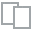
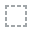
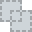
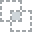
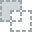
...
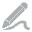
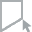
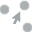
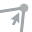
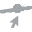

In [8]:
from dataprep.eda import create_report
report = create_report(df)

report.show()

In [9]:
df.shape

(39644, 61)

In [10]:
df.describe()

,timedelta,n_tokens_title,n_tokens_content,n_unique_tokens,n_non_stop_words,n_non_stop_unique_tokens,num_hrefs,num_self_hrefs,num_imgs,num_videos,...,min_positive_polarity,max_positive_polarity,avg_negative_polarity,min_negative_polarity,max_negative_polarity,title_subjectivity,title_sentiment_polarity,abs_title_subjectivity,abs_title_sentiment_polarity,shares
count,39644.000000,39644.000000,39644.000000,39644.000000,39644.000000,39644.000000,39644.000000,39644.000000,39644.000000,39644.000000,...,39644.000000,39644.000000,39644.000000,39644.000000,39644.000000,39644.000000,39644.000000,39644.000000,39644.000000,39644.000000
mean,354.530471,10.398749,546.514731,0.548216,0.996469,0.689175,10.883690,3.293638,4.544143,1.249874,...,0.095446,0.756728,-0.259524,-0.521944,-0.107500,0.282353,0.071425,0.341843,0.156064,3395.380184
std,214.163767,2.114037,471.107508,3.520708,5.231231,3.264816,11.332017,3.855141,8.309434,4.107855,...,0.071315,0.247786,0.127726,0.290290,0.095373,0.324247,0.265450,0.188791,0.226294,11626.950749
min,8.000000,2.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,...,0.000000,0.000000,-1.000000,-1.000000,-1.000000,0.000000,-1.000000,0.000000,0.000000,1.000000
25%,164.000000,9.000000,246.000000,0.470870,1.000000,0.625739,4.000000,1.000000,1.000000,0.000000,...,0.050000,0.600000,-0.328383,-0.700000,-0.125000,0.000000,0.000000,0.166667,0.000000,946.000000
50%,339.000000,10.000000,409.000000,0.539226,1.000000,0.690476,8.000000,3.000000,1.000000,0.000000,...,0.100000,0.800000,-0.253333,-0.500000,-0.100000,0.150000,0.000000,0.500000,0.000000,1400.000000
75%,542.000000,12.000000,716.000000,0.608696,1.000000,0.754630,14.000000,4.000000,4.000000,1.000000,...,0.100000,1.000000,-0.186905,-0.300000,-0.050000,0.500000,0.150000,0.500000,0.250000,2800.000000
max,731.000000,23.000000,8474.000000,701.000000,1042.000000,650.000000,304.000000,116.000000,128.000000,91.000000,...,1.000000,1.000000,0.000000,0.000000,0.000000,1.000000,1.000000,0.500000,1.000000,843300.000000


**From Shape and Describe I can see the entire dataset is mostly numerical with one categorical feature*

In [11]:
df.info()

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 39644 entries, 0 to 39643
Data columns (total 61 columns):
 #   Column                          Non-Null Count  Dtype  
---  ------                          --------------  -----  
 0   url                             39644 non-null  object 
 1    timedelta                      39644 non-null  int64  
 2    n_tokens_title                 39644 non-null  int64  
 3    n_tokens_content               39644 non-null  int64  
 4    n_unique_tokens                39644 non-null  float64
 5    n_non_stop_words               39644 non-null  float64
 6    n_non_stop_unique_tokens       39644 non-null  float64
 7    num_hrefs                      39644 non-null  int64  
 8    num_self_hrefs                 39644 non-null  int64  
 9    num_imgs                       39644 non-null  int64  
 10   num_videos                     39644 non-null  int64  
 11   average_token_length           39644 non-null  float64
 12   num_keywords                   

**There appear to be spaces in the feature headers so I need to check for same**

In [12]:
# Check for spaces in column headers
columns_with_spaces = [col for col in df.columns if ' ' in col]

if columns_with_spaces:
    print("Columns with spaces:", columns_with_spaces)
else:
    print("No columns have spaces in their names.")

Columns with spaces: [' timedelta', ' n_tokens_title', ' n_tokens_content', ' n_unique_tokens', ' n_non_stop_words', ' n_non_stop_unique_tokens', ' num_hrefs', ' num_self_hrefs', ' num_imgs', ' num_videos', ' average_token_length', ' num_keywords', ' data_channel_is_lifestyle', ' data_channel_is_entertainment', ' data_channel_is_bus', ' data_channel_is_socmed', ' data_channel_is_tech', ' data_channel_is_world', ' kw_min_min', ' kw_max_min', ' kw_avg_min', ' kw_min_max', ' kw_max_max', ' kw_avg_max', ' kw_min_avg', ' kw_max_avg', ' kw_avg_avg', ' self_reference_min_shares', ' self_reference_max_shares', ' self_reference_avg_sharess', ' weekday_is_monday', ' weekday_is_tuesday', ' weekday_is_wednesday', ' weekday_is_thursday', ' weekday_is_friday', ' weekday_is_saturday', ' weekday_is_sunday', ' is_weekend', ' LDA_00', ' LDA_01', ' LDA_02', ' LDA_03', ' LDA_04', ' global_subjectivity', ' global_sentiment_polarity', ' global_rate_positive_words', ' global_rate_negative_words', ' rate_posi

**I'll remove these spaces for so there are no errors in processing the data**

In [13]:
df.columns = [col.strip() for col in df.columns]


**As per the data dictionary, our target variable is 'shares'.  We need to clean the data further to determine the independant variables that are most important in analyzing the data.  To proceed towards cleaning and feature engineering, we need to understand the data better**

In [14]:
df.head()

,url,timedelta,n_tokens_title,n_tokens_content,n_unique_tokens,n_non_stop_words,n_non_stop_unique_tokens,num_hrefs,num_self_hrefs,num_imgs,...,min_positive_polarity,max_positive_polarity,avg_negative_polarity,min_negative_polarity,max_negative_polarity,title_subjectivity,title_sentiment_polarity,abs_title_subjectivity,abs_title_sentiment_polarity,shares
0,http://mashable.com/2013/01/07/amazon-instant-...,731,12,219,0.663594,1.0,0.815385,4,2,1,...,0.100000,0.7,-0.350000,-0.600,-0.200000,0.500000,-0.187500,0.000000,0.187500,593
1,http://mashable.com/2013/01/07/ap-samsung-spon...,731,9,255,0.604743,1.0,0.791946,3,1,1,...,0.033333,0.7,-0.118750,-0.125,-0.100000,0.000000,0.000000,0.500000,0.000000,711
2,http://mashable.com/2013/01/07/apple-40-billio...,731,9,211,0.575130,1.0,0.663866,3,1,1,...,0.100000,1.0,-0.466667,-0.800,-0.133333,0.000000,0.000000,0.500000,0.000000,1500
3,http://mashable.com/2013/01/07/astronaut-notre...,731,9,531,0.503788,1.0,0.665635,9,0,1,...,0.136364,0.8,-0.369697,-0.600,-0.166667,0.000000,0.000000,0.500000,0.000000,1200
4,http://mashable.com/2013/01/07/att-u-verse-apps/,731,13,1072,0.415646,1.0,0.540890,19,19,20,...,0.033333,1.0,-0.220192,-0.500,-0.050000,0.454545,0.136364,0.045455,0.136364,505


**From this initial look, I can determine that I will probably need to split the dataset.   I come to this conclusion as, even though the content is numerical, there are several features that are boolean which refers to a categorical conclusion, rather than a numerical conclusion**

In [15]:
df.describe()

,timedelta,n_tokens_title,n_tokens_content,n_unique_tokens,n_non_stop_words,n_non_stop_unique_tokens,num_hrefs,num_self_hrefs,num_imgs,num_videos,...,min_positive_polarity,max_positive_polarity,avg_negative_polarity,min_negative_polarity,max_negative_polarity,title_subjectivity,title_sentiment_polarity,abs_title_subjectivity,abs_title_sentiment_polarity,shares
count,39644.000000,39644.000000,39644.000000,39644.000000,39644.000000,39644.000000,39644.000000,39644.000000,39644.000000,39644.000000,...,39644.000000,39644.000000,39644.000000,39644.000000,39644.000000,39644.000000,39644.000000,39644.000000,39644.000000,39644.000000
mean,354.530471,10.398749,546.514731,0.548216,0.996469,0.689175,10.883690,3.293638,4.544143,1.249874,...,0.095446,0.756728,-0.259524,-0.521944,-0.107500,0.282353,0.071425,0.341843,0.156064,3395.380184
std,214.163767,2.114037,471.107508,3.520708,5.231231,3.264816,11.332017,3.855141,8.309434,4.107855,...,0.071315,0.247786,0.127726,0.290290,0.095373,0.324247,0.265450,0.188791,0.226294,11626.950749
min,8.000000,2.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,...,0.000000,0.000000,-1.000000,-1.000000,-1.000000,0.000000,-1.000000,0.000000,0.000000,1.000000
25%,164.000000,9.000000,246.000000,0.470870,1.000000,0.625739,4.000000,1.000000,1.000000,0.000000,...,0.050000,0.600000,-0.328383,-0.700000,-0.125000,0.000000,0.000000,0.166667,0.000000,946.000000
50%,339.000000,10.000000,409.000000,0.539226,1.000000,0.690476,8.000000,3.000000,1.000000,0.000000,...,0.100000,0.800000,-0.253333,-0.500000,-0.100000,0.150000,0.000000,0.500000,0.000000,1400.000000
75%,542.000000,12.000000,716.000000,0.608696,1.000000,0.754630,14.000000,4.000000,4.000000,1.000000,...,0.100000,1.000000,-0.186905,-0.300000,-0.050000,0.500000,0.150000,0.500000,0.250000,2800.000000
max,731.000000,23.000000,8474.000000,701.000000,1042.000000,650.000000,304.000000,116.000000,128.000000,91.000000,...,1.000000,1.000000,0.000000,0.000000,0.000000,1.000000,1.000000,0.500000,1.000000,843300.000000


**From here I can see two things**

1. I will need to look at the outliers and decide how to deal with them
2. There are zero values in some of the features, after referring to the data dictionary, the zero values in n_token_content means there is no content and therefore no new or article.  I can therefore remove these rows as they provide no information**

In [16]:
print(df.columns)


Index(['url', 'timedelta', 'n_tokens_title', 'n_tokens_content',
       'n_unique_tokens', 'n_non_stop_words', 'n_non_stop_unique_tokens',
       'num_hrefs', 'num_self_hrefs', 'num_imgs', 'num_videos',
       'average_token_length', 'num_keywords', 'data_channel_is_lifestyle',
       'data_channel_is_entertainment', 'data_channel_is_bus',
       'data_channel_is_socmed', 'data_channel_is_tech',
       'data_channel_is_world', 'kw_min_min', 'kw_max_min', 'kw_avg_min',
       'kw_min_max', 'kw_max_max', 'kw_avg_max', 'kw_min_avg', 'kw_max_avg',
       'kw_avg_avg', 'self_reference_min_shares', 'self_reference_max_shares',
       'self_reference_avg_sharess', 'weekday_is_monday', 'weekday_is_tuesday',
       'weekday_is_wednesday', 'weekday_is_thursday', 'weekday_is_friday',
       'weekday_is_saturday', 'weekday_is_sunday', 'is_weekend', 'LDA_00',
       'LDA_01', 'LDA_02', 'LDA_03', 'LDA_04', 'global_subjectivity',
       'global_sentiment_polarity', 'global_rate_positive_words',
     

In [17]:
df_drop = df[df['n_tokens_content'] != 0]


In [18]:
sum = df_drop['n_tokens_content'][df_drop['n_tokens_content'] == 0].sum()

print(sum)

0


**We can now see from the above that there are no 0 vallues in the feature n_tokens_content**

**I then take a look at how the shape has changed**

In [19]:
df_drop.shape

(38463, 61)

**It has reduced approximately 1100 rows.  I will just take a look at the percentage of this**

In [20]:
rows_df = df.shape[0]

rows_df_drop = df_drop.shape[0]

percentage = (rows_df- rows_df_drop) / rows_df* 100

print(percentage)

2.979013217636969


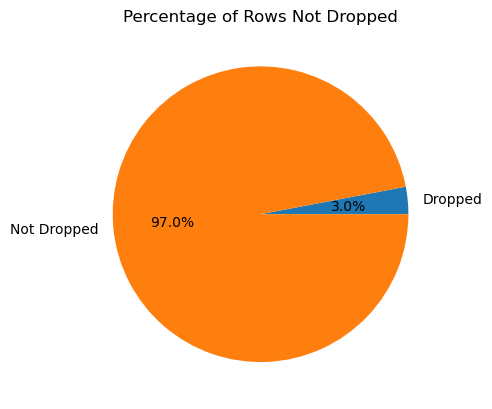

In [21]:
labels = ['Dropped', 'Not Dropped']
values = [2.979013217636969, 100-2.979013217636969]

# Create pie chart
plt.pie(values, labels=labels, autopct='%1.1f%%')
plt.title('Percentage of Rows Not Dropped')
plt.show()

**Figure 1**

**I can see here that I've lost just under 3% of the dataframe which is a good result**

**The only feature that is an object is the url and it provides no valuable information so I can drop it**

**If there was a feature that was an object that was relevant, I would have proceeded to encoding**

In [22]:
df1 = df.drop('url', axis = 1)

In [23]:
df1.head()

,timedelta,n_tokens_title,n_tokens_content,n_unique_tokens,n_non_stop_words,n_non_stop_unique_tokens,num_hrefs,num_self_hrefs,num_imgs,num_videos,...,min_positive_polarity,max_positive_polarity,avg_negative_polarity,min_negative_polarity,max_negative_polarity,title_subjectivity,title_sentiment_polarity,abs_title_subjectivity,abs_title_sentiment_polarity,shares
0,731,12,219,0.663594,1.0,0.815385,4,2,1,0,...,0.100000,0.7,-0.350000,-0.600,-0.200000,0.500000,-0.187500,0.000000,0.187500,593
1,731,9,255,0.604743,1.0,0.791946,3,1,1,0,...,0.033333,0.7,-0.118750,-0.125,-0.100000,0.000000,0.000000,0.500000,0.000000,711
2,731,9,211,0.575130,1.0,0.663866,3,1,1,0,...,0.100000,1.0,-0.466667,-0.800,-0.133333,0.000000,0.000000,0.500000,0.000000,1500
3,731,9,531,0.503788,1.0,0.665635,9,0,1,0,...,0.136364,0.8,-0.369697,-0.600,-0.166667,0.000000,0.000000,0.500000,0.000000,1200
4,731,13,1072,0.415646,1.0,0.540890,19,19,20,0,...,0.033333,1.0,-0.220192,-0.500,-0.050000,0.454545,0.136364,0.045455,0.136364,505


In [24]:
df1['LDA_00'].unique()

array([0.5003312 , 0.79975569, 0.21779229, ..., 0.0293487 , 0.15900446,
       0.04000361])

**The above identifies the relevant topics so it is not a feature that is justifyable to drop**

In [25]:

duplicates = df1.duplicated().sum()
duplicates

0

**There are no dupicates in the dataframe**

**I then took a look at the distribution of the target variable**

In [26]:
duplicates = df1['shares'].duplicated().sum()
duplicates

38190

In [27]:
unique =df1['shares'].nunique()
unique

1454

In [28]:
total = df1['shares'].count()
total

39644

In [29]:
unique_value = unique / total
unique_value

0.03667642013923923

<Axes: xlabel='shares', ylabel='Density'>

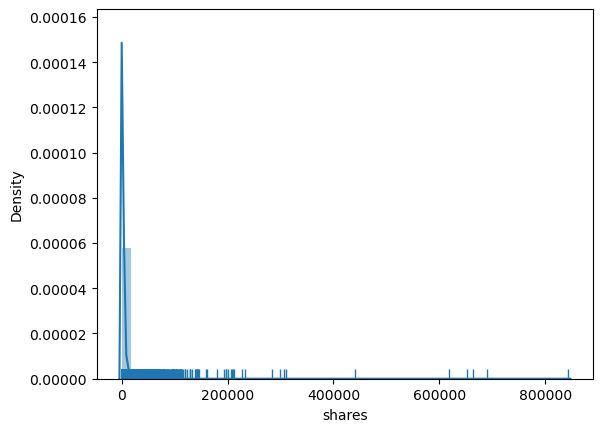

In [30]:
sns.distplot(df1['shares'], kde=True, rug=True)

**Figure 2**

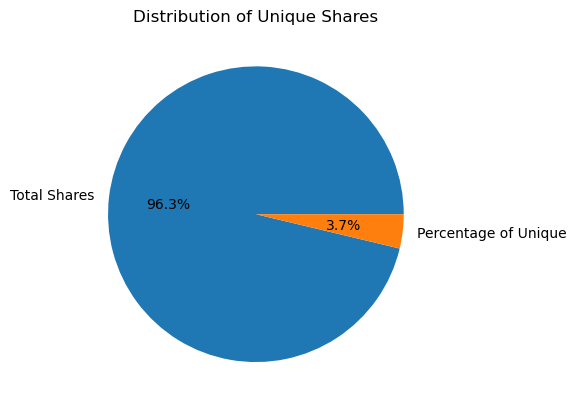

In [31]:
labels = ['Total Shares', 'Percentage of Unique ']
values = [ (100-(0.03730858227387359*100)),(0.03730858227387359*100)]

# Create pie chart
plt.pie(values, labels=labels, autopct='%1.1f%%')
plt.title('Distribution of Unique Shares')
plt.show()

**Figure 3**

**From the above observations we can see that the unique values of shares are around 3.7%.  The data is fairly evenly distributed at the lower end of the scale, below 5000 but spread marginally across 20,000, 40,000, 60,000 and 80,000 shares** 



**I can now look at outliers before engaging in feature selection**

### Outliers

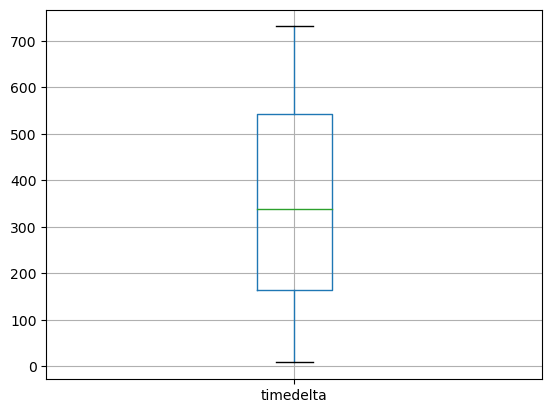

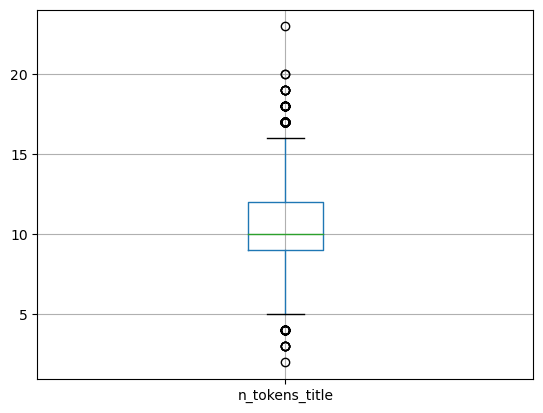

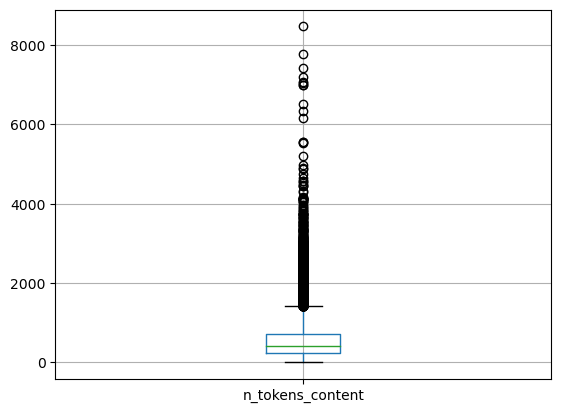

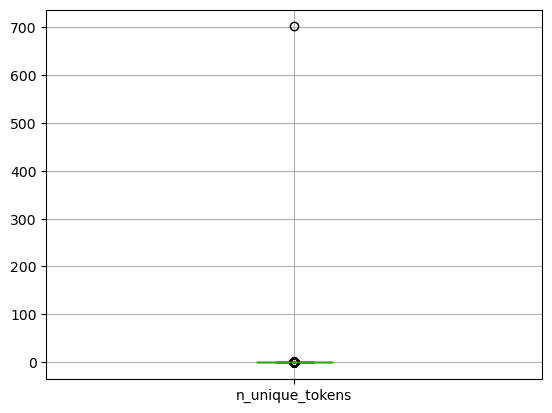

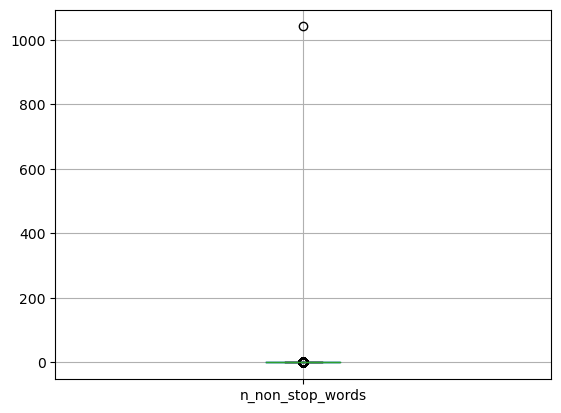

...

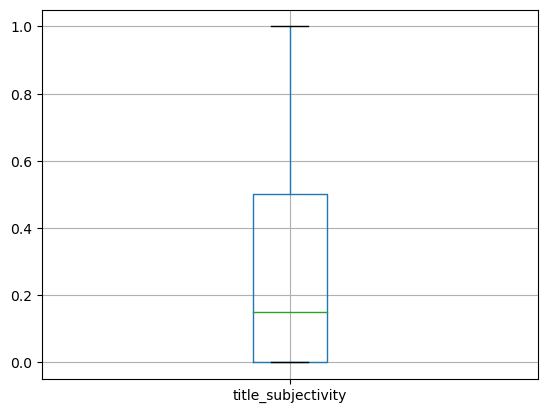

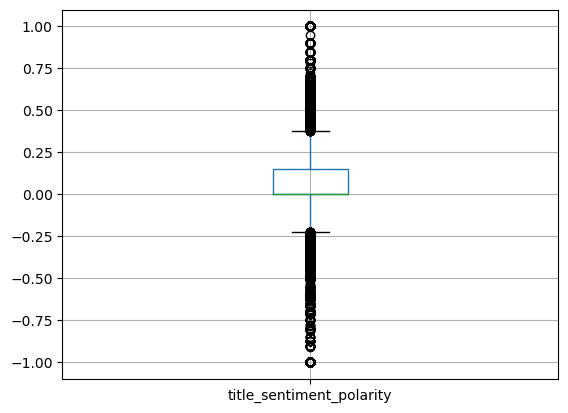

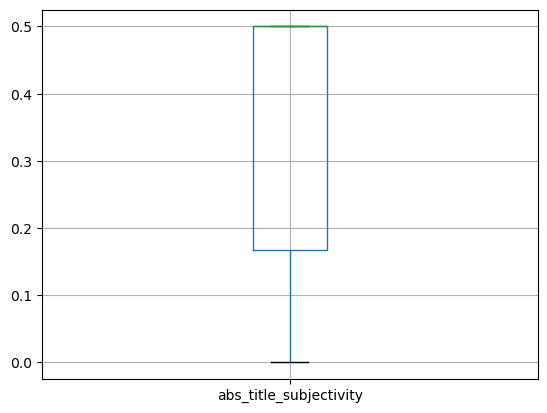

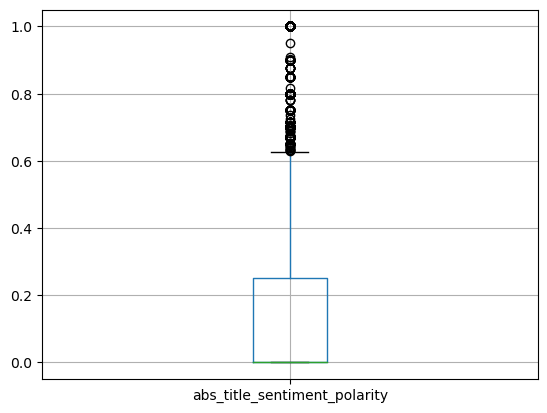

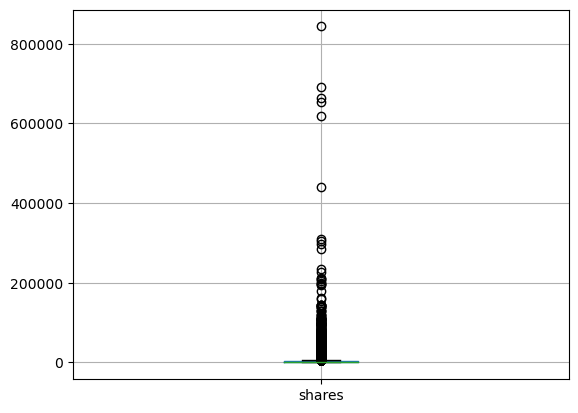

In [32]:
for column in df1:
    plt.figure()
    df1.boxplot(column)

**Figure 4**

From here I can identify columns with significant outliers are 

n_tokens_title  
n_tokens_content  
num_hregs  
num_self_hrefs  
num_imgs  
num_videos  
average_token_length  
kw_min_min  
kw_max_min  
kw_avg_min  
kw_min_max  
kw_max_max  
kw_avg_max  
kw_max_avg  
kw_avg_avg  
self_reference_min_shares  
self_reference_max_shares  
self_reference_avg_sharess  
LDA_00  
LDA_01  
LDA_02  
global_subjectivity  
global_sentiment_polarity  
global_rate_positive_words  
global_rate_negative_words  
rate_negative_words  
avg_positive_polarity  
min_positive_polarity  
avg_negative_polarity  
max_negative_polarity  
title_sentiment_polarity  
abs_title_sentiment_polarity  


**Implimenting IQR**

In [33]:
numerical = [ 'n_tokens_title','num_hrefs','num_self_hrefs','num_imgs','num_videos','average_token_length','kw_min_min',
             'kw_max_min','kw_avg_min','kw_min_max','kw_max_max','kw_avg_max','kw_max_avg','kw_avg_avg',
             'self_reference_min_shares','self_reference_max_shares','self_reference_avg_sharess',
             'LDA_00','LDA_01','LDA_02','global_subjectivity','global_sentiment_polarity','global_rate_positive_words',
             'global_rate_negative_words','rate_negative_words','avg_positive_polarity','min_positive_polarity',
             'avg_negative_polarity','max_negative_polarity','title_sentiment_polarity','abs_title_sentiment_polarity']



def detect_outliers(d):
  for i in d:
    Q3, Q1 = np.percentile(df1[i], [75 ,25])
    IQR = Q3 - Q1

    ul = Q3+1.5*IQR
    ll = Q1-1.5*IQR

    outliers = df1[i][(df1[i] > ul) | (df1[i] < ll)]
    print(f'*** {i} outlier points***', '\n', outliers, '\n')
   


**Detecting Outliers**

In [34]:
detect_outliers(numerical)


*** n_tokens_title outlier points*** 
 588      18
629       4
804      18
861      17
993       4
         ..
39308    17
39323    19
39390     4
39460    17
39534    18
Name: n_tokens_title, Length: 156, dtype: int64 

*** num_hrefs outlier points*** 
 98        32
103       36
140       31
147       32
174       34
        ... 
39512    102
39558     32
39596     32
39612     32
39617     40
Name: num_hrefs, Length: 2169, dtype: int64 

*** num_self_hrefs outlier points*** 
 4        19
6        20
7        20
16       18
19       24
         ..
39532    15
39606    14
39618     9
39634    13
39637    12
Name: num_self_hrefs, Length: 2090, dtype: int64 

*** num_imgs outlier points*** 
 4        20
6        20
7        20
12       11
14        9
         ..
39613    14
39615    21
39634     9
39636    10
39641    12
Name: num_imgs, Length: 7703, dtype: int64 

*** num_videos outlier points*** 
 13       21
47        6
99       11
126      11
129       3
         ..
39529    12
39556

### Correlation 

**Further consideration for what features are importance as determininants for the target varibable would be to look at Correlation**

<Axes: >

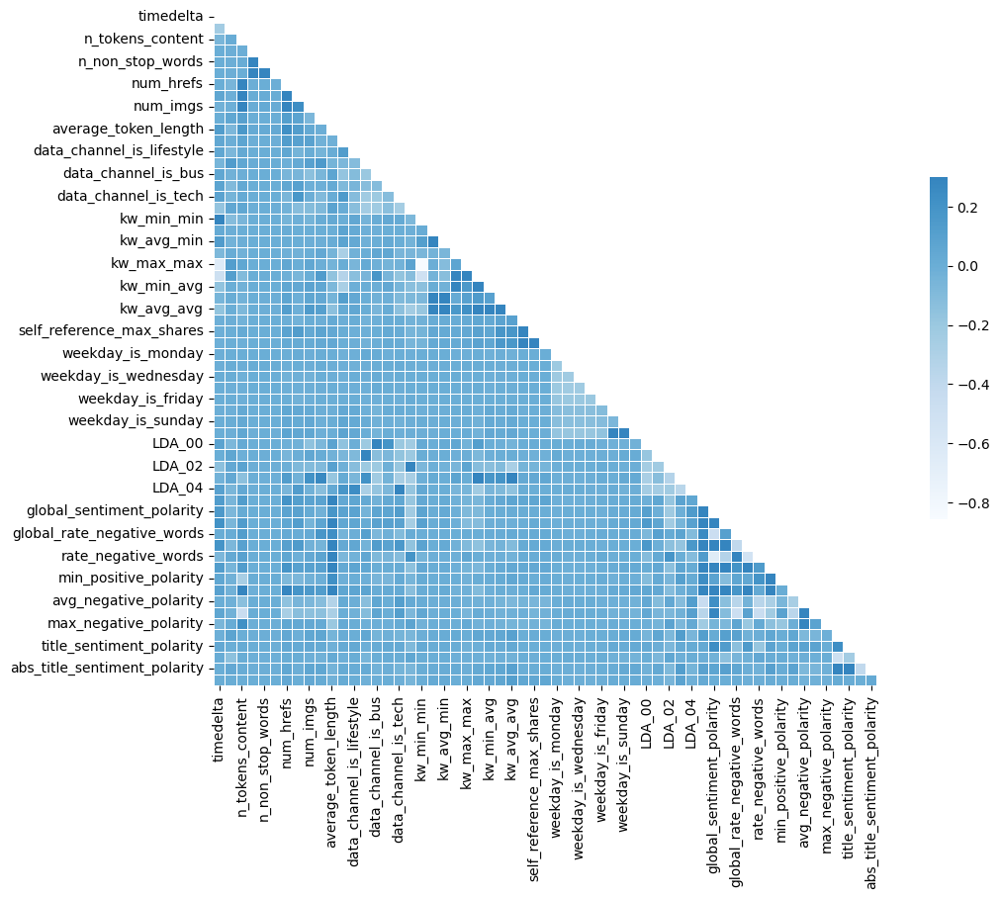

In [35]:
corr = df1.corr()

mask = np.triu(np.ones_like(corr, dtype=bool))

f, ax = plt.subplots(figsize=(11, 9))

cmap = sns.color_palette("Blues", as_cmap=True)

sns.heatmap(corr, mask=mask, cmap=cmap, vmax=.3, center=0,
            square=True, linewidths=.5, cbar_kws={"shrink": .5})

**Figure 5**

**I created a threshold of 0.9 to isolate the strongly correlated features**

In [36]:

threshold = 0.9


strong_correlations = [(feat1, feat2) for feat1 in corr.columns for feat2 in corr.columns if feat1 < feat2 and abs(corr[feat1][feat2]) > threshold]

print(strong_correlations)

[('n_non_stop_words', 'n_unique_tokens'), ('n_non_stop_unique_tokens', 'n_unique_tokens'), ('n_non_stop_unique_tokens', 'n_non_stop_words'), ('kw_avg_min', 'kw_max_min')]


In [37]:
df_corr = df1.drop(columns =['n_non_stop_words', 'n_unique_tokens', 'n_non_stop_unique_tokens','n_non_stop_unique_tokens', 'n_non_stop_words', 'kw_avg_min', 'kw_max_min', 'rate_negative_words', 'rate_positive_words'])

In [38]:
df_corr.head()

,timedelta,n_tokens_title,n_tokens_content,num_hrefs,num_self_hrefs,num_imgs,num_videos,average_token_length,num_keywords,data_channel_is_lifestyle,...,min_positive_polarity,max_positive_polarity,avg_negative_polarity,min_negative_polarity,max_negative_polarity,title_subjectivity,title_sentiment_polarity,abs_title_subjectivity,abs_title_sentiment_polarity,shares
0,731,12,219,4,2,1,0,4.680365,5,0,...,0.100000,0.7,-0.350000,-0.600,-0.200000,0.500000,-0.187500,0.000000,0.187500,593
1,731,9,255,3,1,1,0,4.913725,4,0,...,0.033333,0.7,-0.118750,-0.125,-0.100000,0.000000,0.000000,0.500000,0.000000,711
2,731,9,211,3,1,1,0,4.393365,6,0,...,0.100000,1.0,-0.466667,-0.800,-0.133333,0.000000,0.000000,0.500000,0.000000,1500
3,731,9,531,9,0,1,0,4.404896,7,0,...,0.136364,0.8,-0.369697,-0.600,-0.166667,0.000000,0.000000,0.500000,0.000000,1200
4,731,13,1072,19,19,20,0,4.682836,7,0,...,0.033333,1.0,-0.220192,-0.500,-0.050000,0.454545,0.136364,0.045455,0.136364,505


**I want to further visualise the importance features through decision tree, through train / test Split in this notebook**

## Descriptive Statistics

**We've already looked at the distribution of the target variable, unique values being 3.6%, and the majority of those values being in the lower range**  

**Lets look again at the target variable values and central tendency with the describe function**

In [39]:
df_corr.describe()

,timedelta,n_tokens_title,n_tokens_content,num_hrefs,num_self_hrefs,num_imgs,num_videos,average_token_length,num_keywords,data_channel_is_lifestyle,...,min_positive_polarity,max_positive_polarity,avg_negative_polarity,min_negative_polarity,max_negative_polarity,title_subjectivity,title_sentiment_polarity,abs_title_subjectivity,abs_title_sentiment_polarity,shares
count,39644.000000,39644.000000,39644.000000,39644.000000,39644.000000,39644.000000,39644.000000,39644.000000,39644.000000,39644.000000,...,39644.000000,39644.000000,39644.000000,39644.000000,39644.000000,39644.000000,39644.000000,39644.000000,39644.000000,39644.000000
mean,354.530471,10.398749,546.514731,10.883690,3.293638,4.544143,1.249874,4.548239,7.223767,0.052946,...,0.095446,0.756728,-0.259524,-0.521944,-0.107500,0.282353,0.071425,0.341843,0.156064,3395.380184
std,214.163767,2.114037,471.107508,11.332017,3.855141,8.309434,4.107855,0.844406,1.909130,0.223929,...,0.071315,0.247786,0.127726,0.290290,0.095373,0.324247,0.265450,0.188791,0.226294,11626.950749
min,8.000000,2.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,1.000000,0.000000,...,0.000000,0.000000,-1.000000,-1.000000,-1.000000,0.000000,-1.000000,0.000000,0.000000,1.000000
25%,164.000000,9.000000,246.000000,4.000000,1.000000,1.000000,0.000000,4.478404,6.000000,0.000000,...,0.050000,0.600000,-0.328383,-0.700000,-0.125000,0.000000,0.000000,0.166667,0.000000,946.000000
50%,339.000000,10.000000,409.000000,8.000000,3.000000,1.000000,0.000000,4.664082,7.000000,0.000000,...,0.100000,0.800000,-0.253333,-0.500000,-0.100000,0.150000,0.000000,0.500000,0.000000,1400.000000
75%,542.000000,12.000000,716.000000,14.000000,4.000000,4.000000,1.000000,4.854839,9.000000,0.000000,...,0.100000,1.000000,-0.186905,-0.300000,-0.050000,0.500000,0.150000,0.500000,0.250000,2800.000000
max,731.000000,23.000000,8474.000000,304.000000,116.000000,128.000000,91.000000,8.041534,10.000000,1.000000,...,1.000000,1.000000,0.000000,0.000000,0.000000,1.000000,1.000000,0.500000,1.000000,843300.000000


In [40]:
df_corr['shares'].describe()

count     39644.000000
mean       3395.380184
std       11626.950749
min           1.000000
25%         946.000000
50%        1400.000000
75%        2800.000000
max      843300.000000
Name: shares, dtype: float64

In [41]:
df_corr['shares'].mode()

0    1100
Name: shares, dtype: int64

**Here we can see that the values range from 1 to 843300 which is a large spread.  As per the distplot, we can see that the shares are mostly centralised. I will take a closer look to see if these are closer to the mean, median or mode**

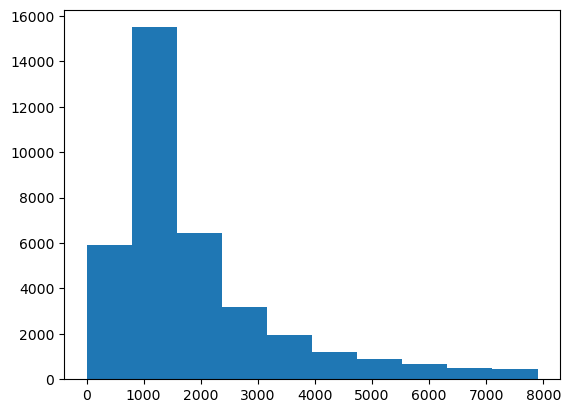

In [42]:
df_shares = df_corr[df_corr['shares'] < 8000]

# Plot a histogram of the 'price' column
plt.hist(df_shares['shares'])
plt.show()

**Figure 6**

**We can see the mean, mode and median are all closely aligned with the data wtih a few anomolies.  These however I have deemed relevant**

#### <font color = blue> Days of the week central tendency 

In [43]:
cols = ['weekday_is_monday', 'weekday_is_tuesday','weekday_is_wednesday','weekday_is_thursday','weekday_is_friday','weekday_is_saturday','weekday_is_sunday','is_weekend']

dfmean = df1[cols].mean()

In [44]:
dfmean.head(8)

weekday_is_monday       0.168020
weekday_is_tuesday      0.186409
weekday_is_wednesday    0.187544
weekday_is_thursday     0.183306
weekday_is_friday       0.143805
weekday_is_saturday     0.061876
weekday_is_sunday       0.069039
is_weekend              0.130915
dtype: float64

In [45]:

lst = cols

lst2 = dfmean
  

dfdays = pd.DataFrame(list(zip(lst, lst2)),
               columns =['Days', 'Mean'])
dfdays

,Days,Mean
0,weekday_is_monday,0.168020
1,weekday_is_tuesday,0.186409
2,weekday_is_wednesday,0.187544
3,weekday_is_thursday,0.183306
4,weekday_is_friday,0.143805
5,weekday_is_saturday,0.061876
6,weekday_is_sunday,0.069039
7,is_weekend,0.130915


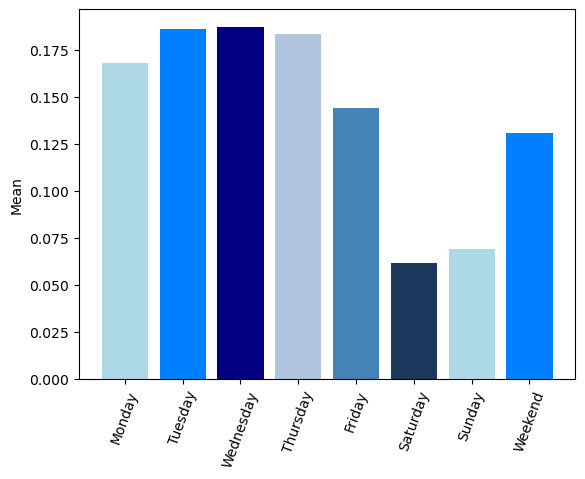

In [46]:

days = ['Monday', 'Tuesday', 'Wednesday', 'Thursday', 'Friday', 'Saturday', 'Sunday', 'Weekend']
means = [0.168240, 0.186439, 0.187323, 0.183345, 0.143983, 0.061592, 0.069079, 0.130671]


fig, ax = plt.subplots()


ax.bar(days, means)

ax.bar(days, means, color=[(0.68, 0.85, 0.9), (0, 0.5, 1), (0, 0, 0.5), (0.69, 0.77, 0.87), (0.27, 0.51, 0.71), (0.11, 0.22, 0.37)])

ax.set_ylabel('Mean')

ax.set_xticklabels(ax.get_xticklabels(), rotation=70)


plt.show()


**Figure 7**

#### <font color = blue> Content / Data Channel Central Tendency 

In [47]:
colsC = ['data_channel_is_lifestyle', 'data_channel_is_entertainment','data_channel_is_bus','data_channel_is_socmed','weekday_is_friday','data_channel_is_tech','data_channel_is_world']

dfmeanC = df1[colsC].mean()

In [48]:
dfmeanC.head(8)

data_channel_is_lifestyle        0.052946
data_channel_is_entertainment    0.178009
data_channel_is_bus              0.157855
data_channel_is_socmed           0.058597
weekday_is_friday                0.143805
data_channel_is_tech             0.185299
data_channel_is_world            0.212567
dtype: float64

In [49]:
# list of strings
lst = colsC
  
# list of int
lst2 = dfmeanC
  
# Calling DataFrame constructor after zipping
# both lists, with columns specified
dfchannel = pd.DataFrame(list(zip(lst, lst2)),
               columns =['Channel', 'Mean'])
dfchannel

,Channel,Mean
0,data_channel_is_lifestyle,0.052946
1,data_channel_is_entertainment,0.178009
2,data_channel_is_bus,0.157855
3,data_channel_is_socmed,0.058597
4,weekday_is_friday,0.143805
5,data_channel_is_tech,0.185299
6,data_channel_is_world,0.212567


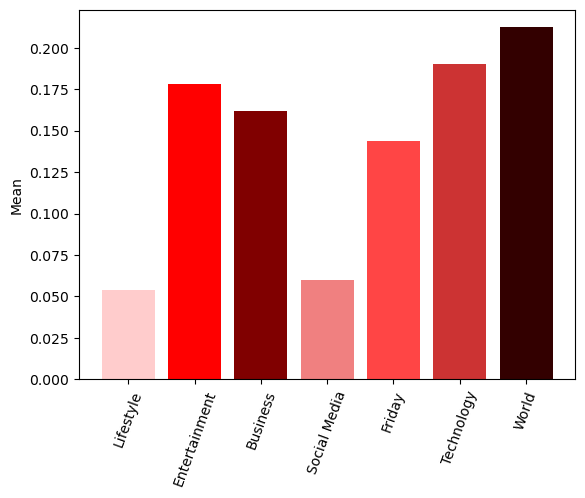

In [50]:

channels = ['Lifestyle', 'Entertainment', 'Business', 'Social Media', 'Friday', 'Technology', 'World']
means = [0.054000, 0.178249, 0.162104, 0.060084, 0.143983, 0.190443, 0.212360]

fig, ax = plt.subplots()


ax.bar(channels, means)

ax.bar(channels, means, color=[(1, 0.8, 0.8), (1, 0, 0), (0.5, 0, 0), (0.94, 0.5, 0.5), (1, 0.27, 0.27), (0.8, 0.2, 0.2), (0.2, 0, 0)])


ax.set_ylabel('Mean')

ax.set_xticklabels(ax.get_xticklabels(), rotation=70)


plt.show()


**Figure 8**

**I'm now going to take a look at the varience of shares on the highest mean of these two measures**

<font color = blue>1. Varience of 'weekday_is_wednesday'

In [51]:
df1['weekday_is_wednesday'].shape

(39644,)

In [52]:

Mean = df1['weekday_is_wednesday'].mean()
n=38463

dev = df1["weekday_is_wednesday"] = df1["weekday_is_wednesday"].apply(lambda x :x - Mean)

dev2= np.square(dev)

data = np.array(dev2)

sum = data.sum()

variance = sum/(n-1)
print(variance)

0.15705395709401418


<font color = blue>2. Varience of 'data_channel_is_world'

In [53]:

Mean = df1['data_channel_is_world'].mean()
n=38463

dev = df1["data_channel_is_world"] = df1["data_channel_is_world"].apply(lambda x :x - Mean)

dev2= np.square(dev)

data = np.array(dev2)

sum = data.sum()

variance = sum/(n-1)
print(variance)

0.17252610883107908


**Both these levels of varience are low, which shows us the target variable is not changing drastically in relation to changegs of the features**

##  Feature Selection 

**As previously viewed, we have two types of data in this dataframe, one is binary to reference a categorical value and the other is numerical to reference a numerical value**

**I am going to split these in order to get accuracy in scaling**

In [54]:
binary_columns = df_corr.isin([0, 1]).all()

# select the binary columns using the boolean index
binary_columns = df_corr.columns[binary_columns]

# print the list of binary columns
print(list(binary_columns))

['data_channel_is_lifestyle', 'data_channel_is_entertainment', 'data_channel_is_bus', 'data_channel_is_socmed', 'data_channel_is_tech', 'data_channel_is_world', 'weekday_is_monday', 'weekday_is_tuesday', 'weekday_is_wednesday', 'weekday_is_thursday', 'weekday_is_friday', 'weekday_is_saturday', 'weekday_is_sunday', 'is_weekend']


In [55]:
df_cat = df1[['data_channel_is_lifestyle', 'data_channel_is_entertainment', 'data_channel_is_bus', 'data_channel_is_socmed', 'data_channel_is_tech', 'data_channel_is_world', 'weekday_is_monday', 'weekday_is_tuesday', 'weekday_is_wednesday', 'weekday_is_thursday', 'weekday_is_friday', 'weekday_is_saturday', 'weekday_is_sunday', 'is_weekend']]

In [56]:
df_cat.head()

,data_channel_is_lifestyle,data_channel_is_entertainment,data_channel_is_bus,data_channel_is_socmed,data_channel_is_tech,data_channel_is_world,weekday_is_monday,weekday_is_tuesday,weekday_is_wednesday,weekday_is_thursday,weekday_is_friday,weekday_is_saturday,weekday_is_sunday,is_weekend
0,0,1,0,0,0,-0.212567,1,0,-0.187544,0,0,0,0,0
1,0,0,1,0,0,-0.212567,1,0,-0.187544,0,0,0,0,0
2,0,0,1,0,0,-0.212567,1,0,-0.187544,0,0,0,0,0
3,0,1,0,0,0,-0.212567,1,0,-0.187544,0,0,0,0,0
4,0,0,0,0,1,-0.212567,1,0,-0.187544,0,0,0,0,0


In [57]:
df_num = df_corr.drop(columns = ['data_channel_is_lifestyle', 'data_channel_is_entertainment', 'data_channel_is_bus', 'data_channel_is_socmed', 'data_channel_is_tech', 'data_channel_is_world', 'weekday_is_monday', 'weekday_is_tuesday', 'weekday_is_wednesday', 'weekday_is_thursday', 'weekday_is_friday', 'weekday_is_saturday', 'weekday_is_sunday', 'is_weekend'])

In [58]:
df_num.head()

,timedelta,n_tokens_title,n_tokens_content,num_hrefs,num_self_hrefs,num_imgs,num_videos,average_token_length,num_keywords,kw_min_min,...,min_positive_polarity,max_positive_polarity,avg_negative_polarity,min_negative_polarity,max_negative_polarity,title_subjectivity,title_sentiment_polarity,abs_title_subjectivity,abs_title_sentiment_polarity,shares
0,731,12,219,4,2,1,0,4.680365,5,0,...,0.100000,0.7,-0.350000,-0.600,-0.200000,0.500000,-0.187500,0.000000,0.187500,593
1,731,9,255,3,1,1,0,4.913725,4,0,...,0.033333,0.7,-0.118750,-0.125,-0.100000,0.000000,0.000000,0.500000,0.000000,711
2,731,9,211,3,1,1,0,4.393365,6,0,...,0.100000,1.0,-0.466667,-0.800,-0.133333,0.000000,0.000000,0.500000,0.000000,1500
3,731,9,531,9,0,1,0,4.404896,7,0,...,0.136364,0.8,-0.369697,-0.600,-0.166667,0.000000,0.000000,0.500000,0.000000,1200
4,731,13,1072,19,19,20,0,4.682836,7,0,...,0.033333,1.0,-0.220192,-0.500,-0.050000,0.454545,0.136364,0.045455,0.136364,505


In [59]:
from scipy.stats.mstats import winsorize

df_winsorized = df_num.clip(lower=df.quantile(0.05), upper=df.quantile(0.95), axis=1)

print(df_winsorized)

       timedelta  n_tokens_title  n_tokens_content  num_hrefs  num_self_hrefs  \
0            697              12               219          4               2   
1            697               9               255          3               1   
2            697               9               211          3               1   
3            697               9               531          9               0   
4            697              13              1072         19               9   
...          ...             ...               ...        ...             ...   
39639         43              11               346          9               7   
39640         43              12               328          9               7   
39641         43              10               442         24               1   
39642         43               7               682         10               1   
39643         43              10               157          1               1   

       num_imgs  num_videos

**I can see the values of the features re-engineered by winsorization above**

In [60]:
df_num = df_winsorized

In [61]:
df_num

,timedelta,n_tokens_title,n_tokens_content,num_hrefs,num_self_hrefs,num_imgs,num_videos,average_token_length,num_keywords,kw_min_min,...,min_positive_polarity,max_positive_polarity,avg_negative_polarity,min_negative_polarity,max_negative_polarity,title_subjectivity,title_sentiment_polarity,abs_title_subjectivity,abs_title_sentiment_polarity,shares
0,697,12,219,4,2,1,0,4.680365,5,0,...,0.100000,0.70,-0.350000,-0.600,-0.200000,0.500000,-0.187500,0.000000,0.187500,593
1,697,9,255,3,1,1,0,4.913725,4,0,...,0.033333,0.70,-0.118750,-0.125,-0.100000,0.000000,0.000000,0.500000,0.000000,711
2,697,9,211,3,1,1,0,4.393365,6,0,...,0.100000,1.00,-0.466667,-0.800,-0.133333,0.000000,0.000000,0.500000,0.000000,1500
3,697,9,531,9,0,1,0,4.404896,7,0,...,0.136364,0.80,-0.369697,-0.600,-0.166667,0.000000,0.000000,0.500000,0.000000,1200
4,697,13,1072,19,9,20,0,4.682836,7,0,...,0.033333,1.00,-0.220192,-0.500,-0.050000,0.454545,0.136364,0.045455,0.136364,584
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
39639,43,11,346,9,7,1,1,4.523121,8,-1,...,0.100000,0.75,-0.260000,-0.500,-0.125000,0.100000,0.000000,0.400000,0.000000,1800
39640,43,12,328,9,7,3,6,4.405488,7,-1,...,0.136364,0.70,-0.211111,-0.400,-0.100000,0.300000,0.500000,0.200000,0.600000,1900
39641,43,10,442,24,1,12,1,5.076923,8,-1,...,0.136364,0.50,-0.356439,-0.800,-0.166667,0.454545,0.136364,0.045455,0.136364,1900
39642,43,7,682,10,1,1,0,4.975073,5,-1,...,0.062500,0.50,-0.205246,-0.500,-0.012500,0.000000,0.000000,0.500000,0.000000,1100


In [62]:
X = df_num.drop("shares",axis=1)
y = df_num.shares

X_train, X_test, y_train, y_test= train_test_split(X,y,test_size=0.2,random_state=41)


In [63]:
X.shape

(39644, 38)

In [64]:
from sklearn.feature_selection import SelectKBest
from sklearn.feature_selection import f_regression

# Set the number of features to select
num_features = 38

# Create a SelectKBest object
selector = SelectKBest(score_func=f_regression, k=num_features)

# Fit the object to the data and get the selected features
X_selected = selector.fit_transform(X, y)

# Get the Boolean mask indicating which features have been selected
mask = selector.get_support()

feature_names = X.columns.tolist()

# Print the names of the selected features
selected_feature_names = [feature_names[i] for i, f in enumerate(mask) if f]
print(selected_feature_names)

['timedelta', 'n_tokens_title', 'n_tokens_content', 'num_hrefs', 'num_self_hrefs', 'num_imgs', 'num_videos', 'average_token_length', 'num_keywords', 'kw_min_min', 'kw_min_max', 'kw_max_max', 'kw_avg_max', 'kw_min_avg', 'kw_max_avg', 'kw_avg_avg', 'self_reference_min_shares', 'self_reference_max_shares', 'self_reference_avg_sharess', 'LDA_00', 'LDA_01', 'LDA_02', 'LDA_03', 'LDA_04', 'global_subjectivity', 'global_sentiment_polarity', 'global_rate_positive_words', 'global_rate_negative_words', 'avg_positive_polarity', 'min_positive_polarity', 'max_positive_polarity', 'avg_negative_polarity', 'min_negative_polarity', 'max_negative_polarity', 'title_subjectivity', 'title_sentiment_polarity', 'abs_title_subjectivity', 'abs_title_sentiment_polarity']


In [65]:
count = len(selected_feature_names)
print(count)  

38


In [66]:
y.median()

1400.0

In [67]:
def threshold(x, threshold):
    if x >= threshold:
        return 1
    else:
        return 0

In [68]:
threshold_value = 1400

# Apply the threshold function to the feature
y = [threshold(x, threshold_value) for x in y]

In [69]:
print(y)

[0, 0, 1, 0, 0, 0, 0, 0, 1, 0, 1, 1, 0, 1, 0, 1, 1, 1, 1, 1, 1, 0, 0, 1, 0, 0, 1, 1, 0, 0, 1, 1, 0, 0, 1, 0, 1, 1, 0, 1, 0, 0, 1, 0, 1, 0, 0, 0, 0, 0, 1, 0, 0, 1, 1, 1, 0, 0, 0, 0, 0, 0, 0, 0, 0, 1, 0, 1, 0, 0, 0, 1, 0, 0, 0, 0, 0, 1, 0, 0, 0, 1, 0, 0, 0, 1, 1, 0, 1, 0, 0, 0, 0, 0, 1, 1, 1, 0, 0, 1, 0, 0, 0, 0, 0, 1, 0, 1, 0, 0, 1, 1, 1, 1, 0, 0, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 1, 1, 0, 1, 1, 1, 0, 0, 0, 1, 1, 1, 0, 0, 0, 1, 1, 0, 1, 0, 1, 1, 1, 0, 0, 1, 0, 1, 0, 0, 1, 0, 1, 0, 0, 0, 0, 0, 1, 1, 1, 1, 0, 0, 1, 0, 0, 1, 1, 0, 1, 1, 0, 0, 0, 0, 1, 0, 0, 0, 1, 0, 1, 0, 0, 0, 1, 0, 1, 0, 1, 1, 1, 0, 1, 0, 0, 0, 1, 1, 0, 0, 1, 1, 1, 1, 0, 1, 1, 1, 1, 0, 1, 0, 0, 0, 0, 1, 1, 0, 1, 0, 0, 1, 1, 0, 0, 0, 1, 0, 1, 0, 0, 0, 0, 1, 1, 0, 0, 0, 1, 0, 1, 1, 0, 0, 1, 1, 1, 0, 1, 1, 0, 0, 1, 1, 0, 1, 1, 0, 1, 0, 0, 1, 1, 1, 1, 1, 0, 0, 1, 1, 0, 1, 1, 0, 0, 1, 0, 0, 1, 0, 1, 1, 1, 1, 1, 1, 1, 1, 0, 1, 0, 0, 1, 1, 1, 1, 0, 0, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 0, 1, 1, 0, 

In [70]:
df_num['shares'] = y 

In [71]:
df_num['shares'].head()

0    0
1    0
2    1
3    0
4    0
Name: shares, dtype: int64

### Scaling and Feature Importance 

In [72]:
from sklearn.preprocessing import MinMaxScaler
from sklearn.ensemble import RandomForestClassifier
from sklearn.model_selection import train_test_split


# Split the data into training and test sets
X_train, X_test, y_train, y_test = train_test_split(X, y, test_size=0.2, random_state=42)

# Scale the training data using the Min-Max Scaler
scaler = MinMaxScaler()
X_train_scaled = scaler.fit_transform(X_train)

# Train the random forest model
model = RandomForestClassifier()
model.fit(X_train_scaled, y_train)

# Scale the test data using the same scaler
X_test_scaled = scaler.transform(X_test)

# Evaluate the model on the test set
accuracy = model.score(X_test_scaled, y_test)
print('Accuracy:', accuracy)



Accuracy: 0.6531719006179846


### Feature Importances

In [73]:
X.shape

(39644, 38)

In [74]:
columns = X.columns
print(columns)

Index(['timedelta', 'n_tokens_title', 'n_tokens_content', 'num_hrefs',
       'num_self_hrefs', 'num_imgs', 'num_videos', 'average_token_length',
       'num_keywords', 'kw_min_min', 'kw_min_max', 'kw_max_max', 'kw_avg_max',
       'kw_min_avg', 'kw_max_avg', 'kw_avg_avg', 'self_reference_min_shares',
       'self_reference_max_shares', 'self_reference_avg_sharess', 'LDA_00',
       'LDA_01', 'LDA_02', 'LDA_03', 'LDA_04', 'global_subjectivity',
       'global_sentiment_polarity', 'global_rate_positive_words',
       'global_rate_negative_words', 'avg_positive_polarity',
       'min_positive_polarity', 'max_positive_polarity',
       'avg_negative_polarity', 'min_negative_polarity',
       'max_negative_polarity', 'title_subjectivity',
       'title_sentiment_polarity', 'abs_title_subjectivity',
       'abs_title_sentiment_polarity'],
      dtype='object')


In [75]:
from sklearn.ensemble import RandomForestClassifier

# Train a random forest model
model = RandomForestClassifier()
model.fit(X, y)

# Get the feature importances
importances = model.feature_importances_

# Sort the feature importances in descending order
indices = np.argsort(importances)[::-1]

# Print the feature ranking
print("Feature ranking:")

for f in range(X.shape[1]):
    print("%d. feature %d (%f)" % (f + 1, indices[f], importances[indices[f]]))


Feature ranking:
1. feature 15 (0.053694)
2. feature 14 (0.047106)
3. feature 21 (0.039328)
4. feature 0 (0.038930)
5. feature 20 (0.037989)
6. feature 23 (0.037651)
7. feature 19 (0.035683)
8. feature 12 (0.034886)
9. feature 24 (0.034225)
10. feature 2 (0.034153)
11. feature 16 (0.034150)
12. feature 18 (0.033906)
13. feature 7 (0.033491)
14. feature 26 (0.033017)
15. feature 22 (0.032368)
16. feature 25 (0.032223)
17. feature 28 (0.031513)
18. feature 27 (0.031025)
19. feature 31 (0.030590)
20. feature 17 (0.028575)
21. feature 13 (0.026810)
22. feature 3 (0.026303)
23. feature 10 (0.020459)
24. feature 32 (0.019143)
25. feature 1 (0.019014)
26. feature 33 (0.017045)
27. feature 35 (0.017013)
28. feature 5 (0.016917)
29. feature 34 (0.016348)
30. feature 29 (0.015542)
31. feature 4 (0.015407)
32. feature 36 (0.015081)
33. feature 37 (0.014175)
34. feature 30 (0.013113)
35. feature 8 (0.012092)
36. feature 6 (0.009162)
37. feature 11 (0.006426)
38. feature 9 (0.005448)


In [76]:
for i, col in enumerate(X.columns[14:16]):
    print("Feature %d: %s" % (i, col))

Feature 0: kw_max_avg
Feature 1: kw_avg_avg


**Feature importance calculates the two most important features are 'kw_max_avg' and 'kw_avg_avg'.  I will use these when performing real average range due to their importances and it would be interesting between two different categories**

## Hypothosis Test 

In [77]:
feature_stds = X.std()

# Sort the standard deviations from low to high
sorted_stds = feature_stds.sort_values()

# Print the sorted standard deviations
print(sorted_stds)

global_rate_negative_words           0.009262
global_rate_positive_words           0.015206
min_positive_polarity                0.047801
max_negative_polarity                0.061653
avg_positive_polarity                0.078495
global_sentiment_polarity            0.083118
global_subjectivity                  0.084082
avg_negative_polarity                0.114558
abs_title_subjectivity               0.188791
abs_title_sentiment_polarity         0.193871
LDA_01                               0.201347
title_sentiment_polarity             0.204910
max_positive_polarity                0.214649
LDA_00                               0.258401
average_token_length                 0.265846
LDA_02                               0.279314
LDA_04                               0.286961
min_negative_polarity                0.290290
LDA_03                               0.291877
title_subjectivity                   0.324247
num_videos                           1.436871
num_keywords                      

**The feature with the lowest standard deviation is 'global_rate_negative_words' whic is the rate of negative words in the content.  I'll perform hypothesis test against 'max_negative_polarity' which is the rate of negative words in an article which would elude to the overall negative sentiment of it.  It would be interesting to see if there is a significant relationship between the two variables**

In [78]:

X1= X['global_rate_negative_words'];X1

0        0.013699
1        0.015686
2        0.009479
3        0.020716
4        0.012127
           ...   
39639    0.014451
39640    0.009146
39641    0.024887
39642    0.023460
39643    0.012739
Name: global_rate_negative_words, Length: 39644, dtype: float64

In [79]:

X2= X['max_negative_polarity'];X2

0       -0.200000
1       -0.100000
2       -0.133333
3       -0.166667
4       -0.050000
           ...   
39639   -0.125000
39640   -0.100000
39641   -0.166667
39642   -0.012500
39643   -0.200000
Name: max_negative_polarity, Length: 39644, dtype: float64

In [80]:
t_test = stats.ttest_ind(X1, X2, equal_var= False)
display(t_test)


Ttest_indResult(statistic=366.7921654087671, pvalue=0.0)

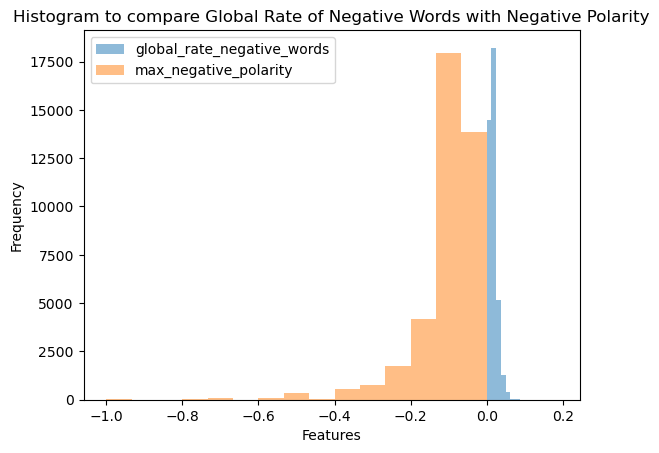

In [81]:

data1 = df1['global_rate_negative_words']
data2 = df1['max_negative_polarity']


bins = 15

colors = sns.color_palette(["#FF0000", "#0000FF"])

# Create the first histogram plot
plt.hist(data1, bins=bins, alpha=0.5, label="global_rate_negative_words")

# Create the second histogram plot
plt.hist(data2, bins=bins, alpha=0.5, label="max_negative_polarity")

# Add a legend
plt.legend()

# Add a title and axis labels
plt.title("Histogram to compare Global Rate of Negative Words with Negative Polarity")
plt.xlabel("Features")
plt.ylabel("Frequency")

# Show the plot
plt.show()


**Above is a histogram of the features I visualised varience for to look at the frequency or number of observations comparitively**

<font color = red> potentially look at the critical values
    
    from scipy.stats import t

alpha = 0.05
degrees_of_freedom = 10

critical_value = t.ppf(1 - alpha, degrees_of_freedom)

print(critical_value)

### Real Average Range of Two Variables

**real average range = (sum of all ranges) / (number of data points)**

In [82]:
column = X['kw_max_avg'].values

def calculate_rar(column):
  # Calculate the mean of the column
  mean = np.mean(column)
  
  # Calculate the difference between the maximum and minimum values in the column
  range = max(column) - min(column)
  
  # Calculate the real average range (RAR)
  rar = range / len(column)
  
  return (rar)



In [83]:


rar = calculate_rar(column)
print(rar) 

0.18167298055191203


In [84]:
column = df['kw_avg_avg'].values

def calculate_rar(column):
  # Calculate the mean of the column
  mean = np.mean(column)
  
  # Calculate the difference between the maximum and minimum values in the column
  range = max(column) - min(column)
  
  # Calculate the real average range (RAR)
  rar = range / len(column)
  
  return (rar)


In [85]:

rar = calculate_rar(column)
print(rar) 

1.0989723526889315


<font color = red> summary for RAR

### Binomial Distribution and two probabilities of this distribution 

The binomial distribution is a discrete probability distribution that models the number of successes in a given number of independent trials, where each trial has two possible outcomes: success or failure. The binomial distribution is determined by two parameters: the number of trials and the probability of success in each trial.

For example, suppose you flip a fair coin 10 times. You could use the binomial distribution to model the number of heads that you get. In this case, the number of trials is 10 and the probability of success (getting a head) is 0.5. You could use the binomial distribution to calculate the probability of getting any number of heads between 0 and 10, inclusive.

The binomial distribution is often used to model situations where there are a fixed number of independent trials, each with a fixed probability of success. It is a widely used distribution in statistical analysis and has many applications in fields such as finance, biology, and quality control.

As we have predicted the features that mostly contribute to the mean target variable, we can use the highest importance variable again to look at binomial distribution 

<font color = red> liturature and citations 

 choose a feature for a binomial distribution, you should consider the following factors:

The feature should have two possible outcomes. These outcomes should be mutually exclusive and exhaustive, meaning that they should cover all possible outcomes and there should be no overlap between them.

The feature should be independent of other features. This means that the outcome of one trial should not be influenced by the outcomes of other trials.

The probability of success should be constant for each trial. This means that the probability of success should be the same for each trial, and should not depend on the outcomes of previous trials.


<font color = red> liturature and citations 

<Axes: >

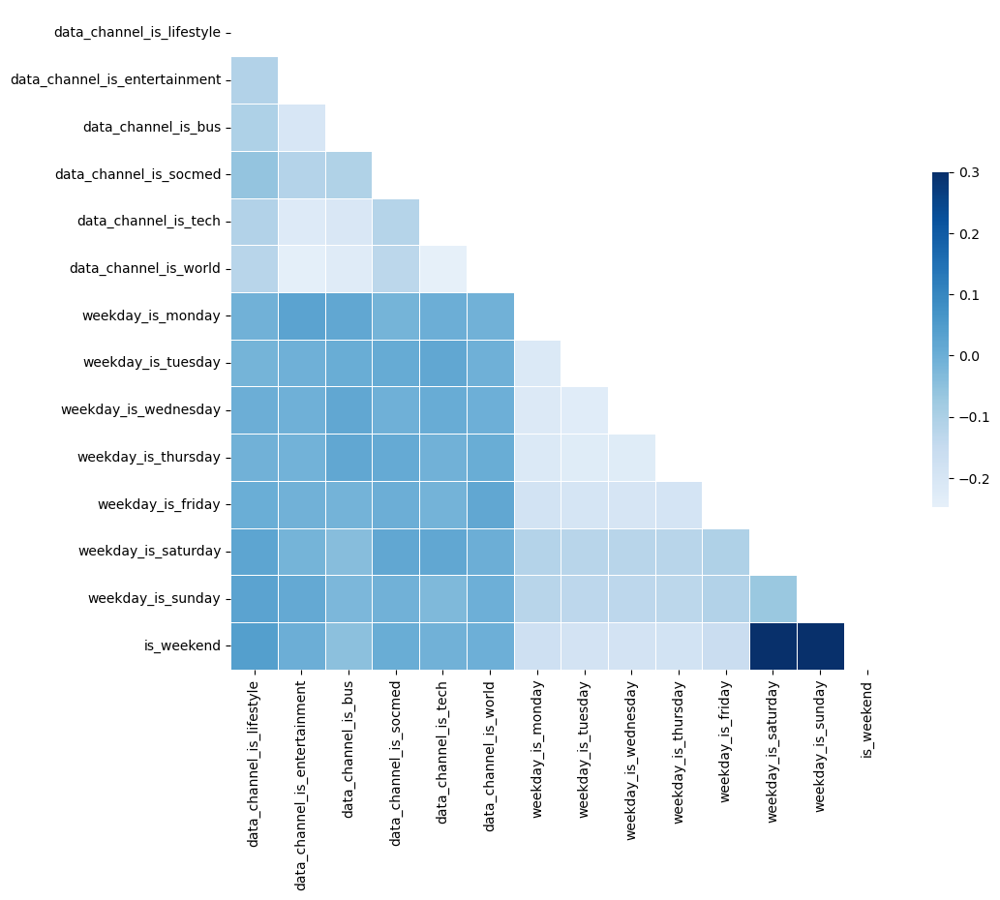

In [86]:
# Calculate the correlation matrix
corr = df_cat.corr()

# Generate a mask for the upper triangle
mask = np.triu(np.ones_like(corr, dtype=bool))

# Set up the matplotlib figure
f, ax = plt.subplots(figsize=(11, 9))

# Generate a custom diverging colormap
cmap = sns.color_palette("Blues", as_cmap=True)

# Draw the heatmap with the mask and correct aspect ratio
sns.heatmap(corr, mask=mask, cmap=cmap, vmax=.3, center=0,
            square=True, linewidths=.5, cbar_kws={"shrink": .5})

**Figure 5**

In [87]:


abs_corr = abs(corr)


weakest_corrs = abs_corr.min(axis=1)


sorted_corrs = weakest_corrs.sort_values()


print(sorted_corrs)


data_channel_is_tech             0.000125
weekday_is_monday                0.000125
data_channel_is_world            0.000621
weekday_is_saturday              0.000621
data_channel_is_socmed           0.000630
weekday_is_friday                0.000630
data_channel_is_lifestyle        0.001012
data_channel_is_entertainment    0.001538
is_weekend                       0.001538
weekday_is_wednesday             0.001632
data_channel_is_bus              0.002745
weekday_is_tuesday               0.002745
weekday_is_sunday                0.003598
weekday_is_thursday              0.003868
dtype: float64


This code appears to be working with a variable called "corr" (presumably a correlation matrix or dataframe) and is performing the following operations:

abs_corr = abs(corr) - this creates a new variable "abs_corr" that contains the absolute values of the "corr" variable.
weakest_corrs = abs_corr.min(axis=1) - this creates a new variable "weakest_corrs" that contains the minimum value of each row in the "abs_corr" variable.
sorted_corrs = weakest_corrs.sort_values() - this creates a new variable "sorted_corrs" that contains the elements of "weakest_corrs" sorted in ascending order.
print(sorted_corrs) - this prints the sorted_corrs variable.
The overall effect of this code is to find the minimum absolute correlation value of each row in the "corr" variable, sort those values, and print the result.

In [88]:
from scipy.stats import binom

Binomial

x = number of people who has passed the exam (within 10 people)

p= 0.70
n= 10

If I don't have p, I can calculate it. 
E = the person passes the exam
P(E) = number of people who passed the exam / total number of students --> p
q = 1-p

In [89]:
df_cat['data_channel_is_tech'].value_counts()

0    32298
1     7346
Name: data_channel_is_tech, dtype: int64

In [90]:
df_cat['data_channel_is_tech'].head()

0    0
1    0
2    0
3    0
4    1
Name: data_channel_is_tech, dtype: int64

In [91]:
7325/31138

0.2352431113109384

**I now use the probability mass function of the binomial distribution**

**Use the formula for the probability mass function of the binomial distribution. The formula is:
P(X = x) = (n choose x) * p^x * (1 - p)^(n - x)**



In [92]:
from math import comb
def binomial_distribution(n, p, k):
    return comb(n, k) * p**k * (1-p)**(n-k)

result = binomial_distribution(6, (7325/31138), 2)
print(result)


0.2839348358080022


In [93]:
from scipy.stats import binom
n = 6
p = 7325/31138
k = 2

probability = binom.pmf(k, n, p)
print(probability)

0.28393483580800233


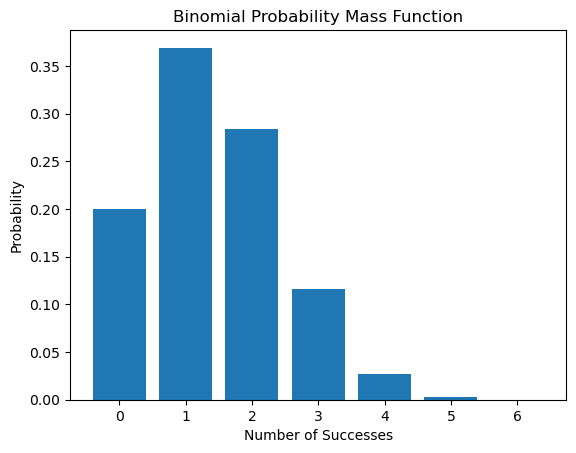

In [94]:

x_values = list(range(n+1))

y_values = [binomial_distribution(n, p, k) for k in x_values]


plt.bar(x_values, y_values)


plt.xlabel('Number of Successes')
plt.ylabel('Probability')
plt.title('Binomial Probability Mass Function')


plt.show()


**Figure 6**

In [95]:
from math import comb
def binomial_distribution(n2, p2, k2):
    return comb(n2, k2) * p2**k2 * (1-p2)**(n2-k2)

result = binomial_distribution(10,(7325/31138), 4)
print(result)

0.12865519861486607


In [96]:
from scipy.stats import binom
n2 = 10
p2 = 7325/31138
k2 = 4

probability = binom.pmf(k2, n2, p2)
print(probability)

0.1286551986148661


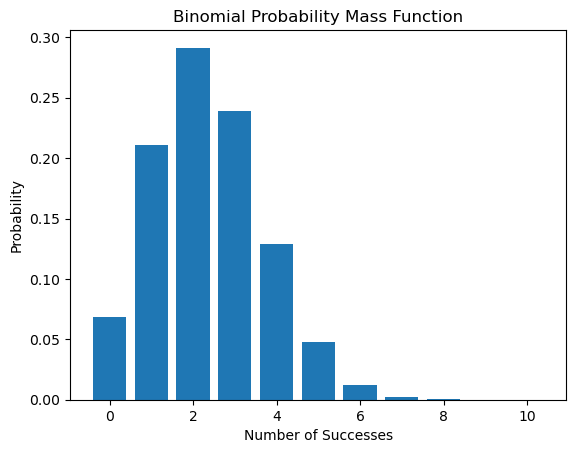

In [97]:

x_values = list(range(n2+1))

y_values = [binomial_distribution(n2, p2, k2) for k2 in x_values]


plt.bar(x_values, y_values)


plt.xlabel('Number of Successes')
plt.ylabel('Probability')
plt.title('Binomial Probability Mass Function')


plt.show()

**Figure 7**